<a href="https://colab.research.google.com/github/Crepopcorn/sit_detection_project/blob/main/final_custom_body.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **YOLOv8**

In [1]:
!nvidia-smi

Thu Mar 14 00:11:15 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off | 00000000:00:04.0 Off |                    0 |
| N/A   32C    P0              45W / 400W |      2MiB / 40960MiB |      0%      Default |
|                                         |                      |             Disabled |
+-----------------------------------------+----------------------+--

In [2]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 721.2/721.2 kB 14.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 72.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 40.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 84.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 1.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 2.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 13.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 30.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 8.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.0/196.0 MB 8.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 166.0/166.0 MB 6.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.1/99.1 kB 15.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━

In [3]:
from google.colab import drive
drive.mount('/content/drive')
# check the uploaded dataset
!ls '/content/drive/My Drive/all_body_update'
!ls '/content/drive/My Drive/all_body_update/train'
!ls '/content/drive/My Drive/all_body_update/valid'

Mounted at /content/drive
data.yaml  README.dataset.txt  README.roboflow.txt  train  valid
images	labels
images	labels


In [4]:
import timeit
from ultralytics import YOLO

start = timeit.default_timer()

model = YOLO("yolov8n.pt")
yaml_file = "/content/drive/My Drive/all_body_update/data.yaml"
results = model.train(data=yaml_file, epochs=100, imgsz=512)  # train the model

stop = timeit.default_timer()
print('Head detector Runtime (seconds): ', stop - start)

100%|██████████| 6.23M/6.23M [00:00<00:00, 352MB/s]


Ultralytics YOLOv8.1.27 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/drive/My Drive/all_body_update/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=512, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, sh

100%|██████████| 755k/755k [00:00<00:00, 108MB/s]


Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

train: Scanning /content/drive/My Drive/all_body_update/train/labels... 810 images, 19 backgrounds, 0 corrupt: 100%|██████████| 810/810 [01:16<00:00, 10.56it/s]


train: New cache created: /content/drive/My Drive/all_body_update/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/My Drive/all_body_update/valid/labels... 120 images, 2 backgrounds, 0 corrupt: 100%|██████████| 120/120 [00:10<00:00, 11.99it/s]

val: New cache created: /content/drive/My Drive/all_body_update/valid/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 512 train, 512 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      1.63G        1.4      1.981      1.315         60        512: 100%|██████████| 51/51 [00:08<00:00,  5.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.88it/s]

                   all        120        392      0.903      0.102      0.371      0.174



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      1.75G      1.305      1.239      1.262         84        512: 100%|██████████| 51/51 [00:04<00:00, 10.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.90it/s]

                   all        120        392       0.53       0.55      0.481      0.241



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      1.64G      1.326      1.242      1.276         55        512: 100%|██████████| 51/51 [00:04<00:00, 10.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.01it/s]

                   all        120        392      0.657      0.549      0.578      0.277



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      1.64G      1.326      1.159      1.279         40        512: 100%|██████████| 51/51 [00:04<00:00, 10.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.00it/s]

                   all        120        392      0.742      0.596      0.687      0.342



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      1.64G      1.297      1.116      1.268         53        512: 100%|██████████| 51/51 [00:04<00:00, 10.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.17it/s]

                   all        120        392      0.732       0.58      0.661        0.3



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      1.64G      1.262      1.038      1.234         51        512: 100%|██████████| 51/51 [00:04<00:00, 10.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.14it/s]

                   all        120        392      0.672      0.649      0.683      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      1.64G      1.261     0.9863       1.24         77        512: 100%|██████████| 51/51 [00:04<00:00, 10.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.20it/s]

                   all        120        392      0.661      0.563      0.624      0.318



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      1.64G      1.253     0.9755      1.246         44        512: 100%|██████████| 51/51 [00:04<00:00, 10.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.04it/s]

                   all        120        392      0.708      0.647      0.697      0.364



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      1.64G      1.235     0.9429      1.227         62        512: 100%|██████████| 51/51 [00:04<00:00, 10.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.46it/s]

                   all        120        392       0.85      0.623      0.726      0.378



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      1.64G      1.209     0.9296      1.218         65        512: 100%|██████████| 51/51 [00:04<00:00, 10.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.57it/s]

                   all        120        392      0.781       0.69       0.78      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      1.64G      1.218     0.9318      1.229         87        512: 100%|██████████| 51/51 [00:04<00:00, 10.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.89it/s]

                   all        120        392      0.757      0.733      0.796      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      1.64G      1.204     0.8881      1.214         60        512: 100%|██████████| 51/51 [00:04<00:00, 10.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.04it/s]

                   all        120        392      0.782      0.648      0.757      0.378



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      1.64G      1.186     0.8555      1.199         63        512: 100%|██████████| 51/51 [00:04<00:00, 10.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.68it/s]

                   all        120        392       0.79        0.7      0.784      0.402



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      1.64G      1.191     0.8535      1.205         51        512: 100%|██████████| 51/51 [00:04<00:00, 10.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.07it/s]

                   all        120        392      0.816       0.71      0.816      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      1.64G      1.189     0.8512      1.208         53        512: 100%|██████████| 51/51 [00:04<00:00, 10.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.94it/s]

                   all        120        392      0.805      0.694        0.8      0.437



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      1.64G      1.133     0.8052      1.168         65        512: 100%|██████████| 51/51 [00:04<00:00, 10.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.61it/s]

                   all        120        392      0.755      0.728      0.801      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      1.64G      1.125     0.7961      1.162         82        512: 100%|██████████| 51/51 [00:04<00:00, 10.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.31it/s]

                   all        120        392      0.797      0.751      0.828      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      1.64G      1.104      0.784      1.165         75        512: 100%|██████████| 51/51 [00:04<00:00, 10.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.21it/s]

                   all        120        392      0.842      0.723      0.826       0.45



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      1.64G      1.149     0.7956      1.179         41        512: 100%|██████████| 51/51 [00:04<00:00, 10.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.02it/s]

                   all        120        392      0.816      0.742      0.815      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      1.64G      1.123     0.7527      1.157         49        512: 100%|██████████| 51/51 [00:04<00:00, 10.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.74it/s]

                   all        120        392      0.703      0.804      0.793      0.418



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      1.64G      1.109     0.7674      1.166         63        512: 100%|██████████| 51/51 [00:04<00:00, 10.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.47it/s]

                   all        120        392      0.777      0.701       0.79      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      1.64G      1.119     0.7523      1.162         57        512: 100%|██████████| 51/51 [00:04<00:00, 10.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.81it/s]

                   all        120        392      0.811      0.755      0.826      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      1.64G      1.104      0.729      1.136         80        512: 100%|██████████| 51/51 [00:04<00:00, 10.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.12it/s]

                   all        120        392      0.791      0.779       0.84      0.462



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      1.64G      1.095     0.7447      1.156         55        512: 100%|██████████| 51/51 [00:04<00:00, 10.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.90it/s]

                   all        120        392      0.777      0.689      0.752       0.42



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      1.64G      1.095     0.7432       1.15         76        512: 100%|██████████| 51/51 [00:04<00:00, 10.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.46it/s]

                   all        120        392      0.795      0.761      0.828      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      1.64G      1.079     0.7132      1.133         43        512: 100%|██████████| 51/51 [00:04<00:00, 10.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.24it/s]

                   all        120        392      0.798      0.763      0.828       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      1.64G      1.092     0.7326      1.145         49        512: 100%|██████████| 51/51 [00:04<00:00, 10.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.06it/s]

                   all        120        392      0.784       0.77      0.832       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      1.64G      1.046     0.7092      1.126         62        512: 100%|██████████| 51/51 [00:04<00:00, 10.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.82it/s]

                   all        120        392      0.826      0.754       0.83      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      1.64G       1.06     0.6851      1.135         55        512: 100%|██████████| 51/51 [00:04<00:00, 10.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.71it/s]

                   all        120        392      0.769      0.756      0.821      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      1.64G      1.032     0.6541      1.113         38        512: 100%|██████████| 51/51 [00:04<00:00, 10.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.02it/s]

                   all        120        392      0.797      0.763      0.823      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      1.64G      1.031     0.6723       1.11         42        512: 100%|██████████| 51/51 [00:04<00:00, 10.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.58it/s]

                   all        120        392      0.845      0.746      0.844      0.483



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      1.64G      1.039     0.6711       1.11         60        512: 100%|██████████| 51/51 [00:04<00:00, 10.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.21it/s]

                   all        120        392      0.796      0.725      0.827      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      1.64G      1.018     0.6426      1.099         59        512: 100%|██████████| 51/51 [00:04<00:00, 10.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.05it/s]

                   all        120        392      0.828       0.69      0.799      0.463



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      1.64G       1.02     0.6453      1.107         56        512: 100%|██████████| 51/51 [00:04<00:00, 10.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.10it/s]

                   all        120        392      0.833      0.756      0.842      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      1.64G      1.016     0.6434      1.091         96        512: 100%|██████████| 51/51 [00:04<00:00, 10.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.56it/s]

                   all        120        392      0.822      0.779      0.849      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      1.64G     0.9859     0.6244      1.084         66        512: 100%|██████████| 51/51 [00:04<00:00, 10.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.44it/s]

                   all        120        392      0.828       0.77      0.846      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      1.64G      1.019     0.6526      1.106         55        512: 100%|██████████| 51/51 [00:04<00:00, 10.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.47it/s]

                   all        120        392      0.773      0.784      0.833      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      1.64G     0.9991     0.6327      1.087         43        512: 100%|██████████| 51/51 [00:04<00:00, 10.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.80it/s]

                   all        120        392      0.766      0.758      0.812       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      1.64G      1.004     0.6246      1.097         53        512: 100%|██████████| 51/51 [00:04<00:00, 10.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.18it/s]

                   all        120        392      0.827      0.733      0.822      0.479



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      1.64G      0.985     0.6209      1.092         55        512: 100%|██████████| 51/51 [00:04<00:00, 10.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.73it/s]

                   all        120        392      0.854      0.725      0.823      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      1.64G     0.9911     0.6189      1.086         52        512: 100%|██████████| 51/51 [00:04<00:00, 10.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.36it/s]

                   all        120        392      0.799      0.715      0.789      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      1.64G     0.9799     0.6194      1.085         35        512: 100%|██████████| 51/51 [00:04<00:00, 10.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.08it/s]

                   all        120        392      0.859      0.748      0.827      0.463



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      1.64G     0.9584     0.6039       1.07        100        512: 100%|██████████| 51/51 [00:04<00:00, 10.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.69it/s]

                   all        120        392      0.846      0.727      0.834      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      1.64G     0.9637     0.5898      1.075         44        512: 100%|██████████| 51/51 [00:04<00:00, 10.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.58it/s]

                   all        120        392      0.823      0.761      0.836      0.468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      1.64G     0.9584     0.5874       1.07         41        512: 100%|██████████| 51/51 [00:04<00:00, 10.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.91it/s]

                   all        120        392      0.852      0.728      0.819      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      1.64G     0.9614     0.5975      1.078         53        512: 100%|██████████| 51/51 [00:04<00:00, 10.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.67it/s]

                   all        120        392      0.817      0.732      0.819      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      1.64G     0.9714     0.5957      1.076         39        512: 100%|██████████| 51/51 [00:04<00:00, 10.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.29it/s]

                   all        120        392      0.842      0.745      0.835      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      1.64G     0.9316     0.5857      1.064         54        512: 100%|██████████| 51/51 [00:04<00:00, 10.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.93it/s]

                   all        120        392      0.837       0.73      0.829      0.483



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      1.64G     0.9259      0.571      1.058         67        512: 100%|██████████| 51/51 [00:04<00:00, 10.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.53it/s]

                   all        120        392      0.837       0.74      0.847      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      1.64G      0.945     0.5759       1.06         37        512: 100%|██████████| 51/51 [00:04<00:00, 10.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.90it/s]

                   all        120        392      0.814      0.776       0.83      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      1.64G     0.9278     0.5633      1.058         96        512: 100%|██████████| 51/51 [00:04<00:00, 10.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.64it/s]

                   all        120        392      0.841      0.747      0.831      0.483



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      1.64G      0.922     0.5526      1.049         51        512: 100%|██████████| 51/51 [00:04<00:00, 10.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.92it/s]

                   all        120        392      0.805      0.763      0.833      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      1.64G     0.9236     0.5511      1.065         43        512: 100%|██████████| 51/51 [00:04<00:00, 10.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.86it/s]

                   all        120        392       0.82      0.746      0.835      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      1.64G     0.9198     0.5354      1.051         35        512: 100%|██████████| 51/51 [00:04<00:00, 10.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.20it/s]

                   all        120        392      0.841      0.759      0.848      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      1.64G     0.9159     0.5548      1.054         64        512: 100%|██████████| 51/51 [00:04<00:00, 10.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.47it/s]

                   all        120        392      0.822      0.777      0.836      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      1.64G     0.9117     0.5512      1.049         90        512: 100%|██████████| 51/51 [00:04<00:00, 10.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.46it/s]

                   all        120        392      0.841      0.758      0.837      0.484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      1.64G     0.9219     0.5492      1.051         45        512: 100%|██████████| 51/51 [00:04<00:00, 10.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.96it/s]

                   all        120        392       0.83      0.735      0.828      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      1.64G     0.8847     0.5422      1.045         33        512: 100%|██████████| 51/51 [00:04<00:00, 10.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.91it/s]

                   all        120        392      0.823      0.735      0.827      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      1.64G     0.8923     0.5388      1.049         55        512: 100%|██████████| 51/51 [00:04<00:00, 10.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.40it/s]

                   all        120        392      0.805      0.761      0.832      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      1.64G     0.8717     0.5278       1.04         41        512: 100%|██████████| 51/51 [00:04<00:00, 10.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.45it/s]

                   all        120        392      0.804      0.799      0.847      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      1.64G     0.8892     0.5343       1.04         55        512: 100%|██████████| 51/51 [00:04<00:00, 10.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.59it/s]

                   all        120        392      0.846      0.762      0.855      0.489



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      1.64G     0.8698     0.5299      1.033         52        512: 100%|██████████| 51/51 [00:04<00:00, 10.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.32it/s]

                   all        120        392      0.857      0.765      0.853      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      1.64G     0.8581     0.5122      1.027         56        512: 100%|██████████| 51/51 [00:04<00:00, 10.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.22it/s]

                   all        120        392      0.867      0.751      0.848      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      1.64G      0.889     0.5284       1.03         64        512: 100%|██████████| 51/51 [00:04<00:00, 10.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.44it/s]

                   all        120        392      0.811      0.803      0.867      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      1.64G     0.8468     0.5052      1.017         62        512: 100%|██████████| 51/51 [00:04<00:00, 10.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.70it/s]

                   all        120        392      0.815      0.744      0.824      0.484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      1.64G     0.8462     0.5054      1.018         42        512: 100%|██████████| 51/51 [00:04<00:00, 10.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.87it/s]

                   all        120        392      0.845      0.732       0.83      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      1.64G     0.8661     0.5124      1.024         48        512: 100%|██████████| 51/51 [00:04<00:00, 11.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.63it/s]

                   all        120        392      0.828      0.778       0.85      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      1.64G     0.8704     0.5134      1.032         46        512: 100%|██████████| 51/51 [00:04<00:00, 10.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.40it/s]

                   all        120        392      0.817      0.792      0.847      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      1.64G     0.8603     0.5127       1.02         59        512: 100%|██████████| 51/51 [00:04<00:00, 10.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.56it/s]

                   all        120        392      0.851      0.779       0.86      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      1.64G     0.8431     0.4978      1.013         58        512: 100%|██████████| 51/51 [00:04<00:00, 10.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.04it/s]

                   all        120        392      0.842      0.774      0.847      0.491



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      1.64G     0.8493     0.5052      1.015         58        512: 100%|██████████| 51/51 [00:04<00:00, 10.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.78it/s]

                   all        120        392      0.808      0.796      0.856      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      1.64G     0.8359     0.4978       1.01         58        512: 100%|██████████| 51/51 [00:04<00:00, 10.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.52it/s]

                   all        120        392      0.836      0.789       0.85      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      1.64G     0.8346     0.4901      1.017         81        512: 100%|██████████| 51/51 [00:04<00:00, 10.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.62it/s]

                   all        120        392      0.834      0.749      0.839      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      1.64G     0.8063     0.4781      1.006         68        512: 100%|██████████| 51/51 [00:04<00:00, 10.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.91it/s]

                   all        120        392      0.833      0.768      0.855      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      1.64G     0.8196     0.4916      1.015         76        512: 100%|██████████| 51/51 [00:04<00:00, 10.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.01it/s]

                   all        120        392      0.838      0.759      0.859      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      1.64G     0.8348     0.4936      1.004         59        512: 100%|██████████| 51/51 [00:04<00:00, 10.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.98it/s]

                   all        120        392      0.848      0.765      0.864      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      1.64G     0.8233     0.4967      1.006         60        512: 100%|██████████| 51/51 [00:04<00:00, 10.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.26it/s]

                   all        120        392       0.86      0.769       0.86      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      1.64G     0.8005     0.4679     0.9922         94        512: 100%|██████████| 51/51 [00:04<00:00, 10.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.43it/s]

                   all        120        392      0.892      0.755      0.865      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      1.64G     0.7986     0.4712     0.9935         51        512: 100%|██████████| 51/51 [00:04<00:00, 10.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.39it/s]

                   all        120        392      0.894      0.768       0.86      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      1.64G     0.7952     0.4598     0.9885         43        512: 100%|██████████| 51/51 [00:04<00:00, 10.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.98it/s]

                   all        120        392      0.851      0.781      0.865      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      1.64G     0.7924      0.456     0.9945         60        512: 100%|██████████| 51/51 [00:04<00:00, 10.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.91it/s]

                   all        120        392      0.876       0.77      0.862      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      1.64G     0.7901     0.4658     0.9896         42        512: 100%|██████████| 51/51 [00:04<00:00, 10.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.60it/s]

                   all        120        392      0.872      0.786      0.857      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      1.64G     0.7825     0.4585     0.9934         64        512: 100%|██████████| 51/51 [00:04<00:00, 10.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.83it/s]

                   all        120        392       0.87      0.759      0.857      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      1.64G      0.787     0.4624      0.991         55        512: 100%|██████████| 51/51 [00:04<00:00, 10.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.60it/s]

                   all        120        392      0.883      0.769      0.871      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      1.64G     0.7744     0.4528     0.9893         57        512: 100%|██████████| 51/51 [00:04<00:00, 10.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.09it/s]

                   all        120        392      0.861      0.781      0.859      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      1.64G     0.7597      0.446     0.9857         53        512: 100%|██████████| 51/51 [00:04<00:00, 10.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.38it/s]

                   all        120        392      0.828      0.789      0.855      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      1.64G     0.7666     0.4607     0.9856         73        512: 100%|██████████| 51/51 [00:04<00:00, 10.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.55it/s]

                   all        120        392      0.824      0.806      0.862      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      1.64G     0.7615     0.4483     0.9848         75        512: 100%|██████████| 51/51 [00:04<00:00, 10.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.18it/s]

                   all        120        392      0.854      0.794      0.867      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      1.64G     0.7527     0.4411     0.9799         49        512: 100%|██████████| 51/51 [00:04<00:00, 10.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.92it/s]

                   all        120        392      0.897      0.742      0.861      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      1.64G     0.7551       0.44     0.9817         61        512: 100%|██████████| 51/51 [00:04<00:00, 10.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.31it/s]

                   all        120        392       0.84      0.802       0.87      0.516


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      1.64G     0.6962     0.3583     0.9367         44        512: 100%|██████████| 51/51 [00:06<00:00,  7.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.64it/s]

                   all        120        392       0.82      0.807      0.862      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      1.64G     0.6853       0.35     0.9343         32        512: 100%|██████████| 51/51 [00:04<00:00, 10.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.42it/s]

                   all        120        392      0.846      0.789      0.868      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      1.64G     0.6776     0.3387     0.9277         28        512: 100%|██████████| 51/51 [00:04<00:00, 11.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.10it/s]

                   all        120        392      0.835      0.811      0.873       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      1.64G     0.6743     0.3352      0.925         28        512: 100%|██████████| 51/51 [00:04<00:00, 11.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.98it/s]

                   all        120        392      0.835      0.795      0.863      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      1.64G      0.671     0.3351     0.9209         42        512: 100%|██████████| 51/51 [00:04<00:00, 10.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.82it/s]

                   all        120        392      0.884      0.763      0.872      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      1.64G     0.6534     0.3271     0.9186         30        512: 100%|██████████| 51/51 [00:04<00:00, 11.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.12it/s]

                   all        120        392      0.847      0.802      0.874      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      1.64G     0.6553     0.3253     0.9253         23        512: 100%|██████████| 51/51 [00:04<00:00, 10.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.83it/s]

                   all        120        392      0.895      0.756      0.869      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      1.64G     0.6466     0.3212     0.9179         51        512: 100%|██████████| 51/51 [00:04<00:00, 11.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.45it/s]

                   all        120        392      0.844      0.804      0.863      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      1.64G     0.6485     0.3272     0.9168         41        512: 100%|██████████| 51/51 [00:04<00:00, 10.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.02it/s]

                   all        120        392       0.83      0.802      0.861      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      1.64G      0.637     0.3176     0.9033         31        512: 100%|██████████| 51/51 [00:04<00:00, 10.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.46it/s]

                   all        120        392       0.86      0.787      0.871      0.516



100 epochs completed in 0.162 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.1.27 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 168 layers, 3006038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.83it/s]


                   all        120        392      0.854      0.792      0.866      0.522
                  body        120        171      0.833      0.754      0.834      0.498
                  head        120        221      0.876       0.83      0.899      0.546
Speed: 0.1ms preprocess, 0.4ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/train
Head detector Runtime (seconds):  695.9336383719999


In [5]:
results = model.val()

Ultralytics YOLOv8.1.27 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 168 layers, 3006038 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/drive/My Drive/all_body_update/valid/labels.cache... 120 images, 2 backgrounds, 0 corrupt: 100%|██████████| 120/120 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.86it/s]


                   all        120        392       0.85      0.798      0.868      0.522
                  body        120        171      0.829      0.766      0.835      0.501
                  head        120        221      0.872       0.83      0.901      0.542
Speed: 0.1ms preprocess, 14.9ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs/detect/train2


In [6]:
model.info(detailed=True)

layer                                     name  gradient   parameters                shape         mu      sigma
    0                      model.0.conv.weight     False          432        [16, 3, 3, 3]      -0.12       3.96 torch.float32
    1                        model.0.conv.bias     False           16                 [16]       1.84       2.16 torch.float32
    2                      model.1.conv.weight     False         4608       [32, 16, 3, 3]   -0.00375      0.275 torch.float32
    3                        model.1.conv.bias     False           32                 [32]       1.65       2.14 torch.float32
    4                  model.2.cv1.conv.weight     False         1024       [32, 32, 1, 1]    -0.0166      0.107 torch.float32
    5                    model.2.cv1.conv.bias     False           32                 [32]       1.65      0.975 torch.float32
    6                  model.2.cv2.conv.weight     False         1536       [32, 48, 1, 1]   -0.00979      0.131 torch.float3

(168, 3006038, 0, 8.086272)

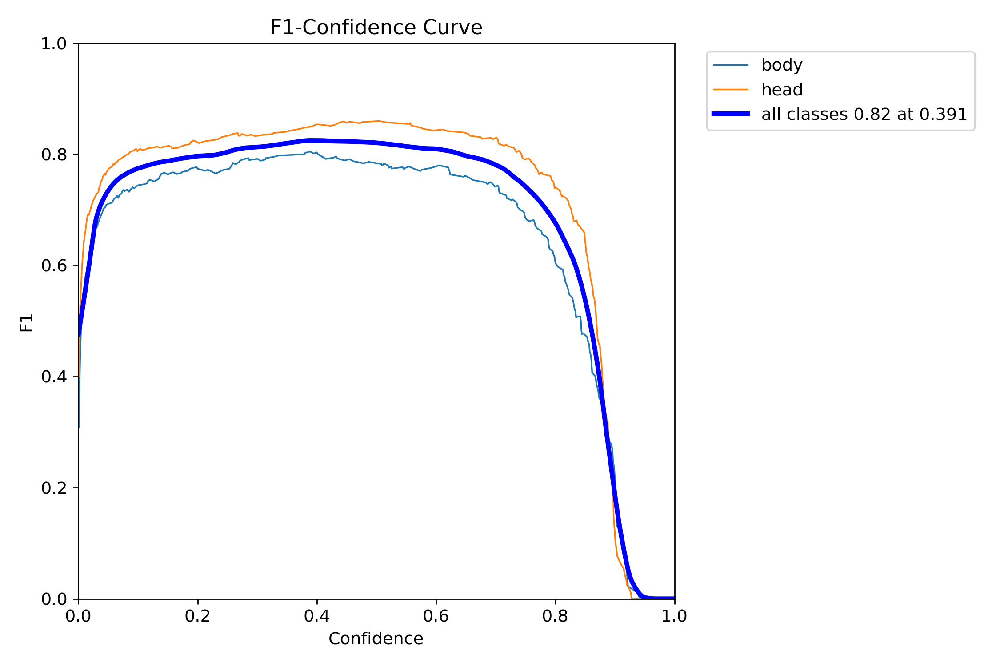

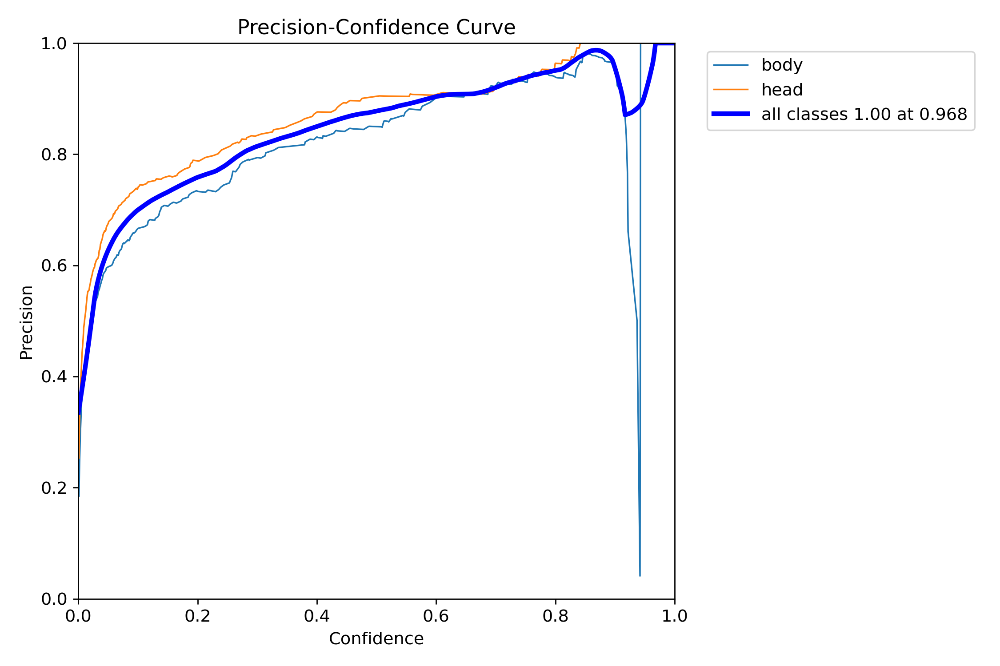

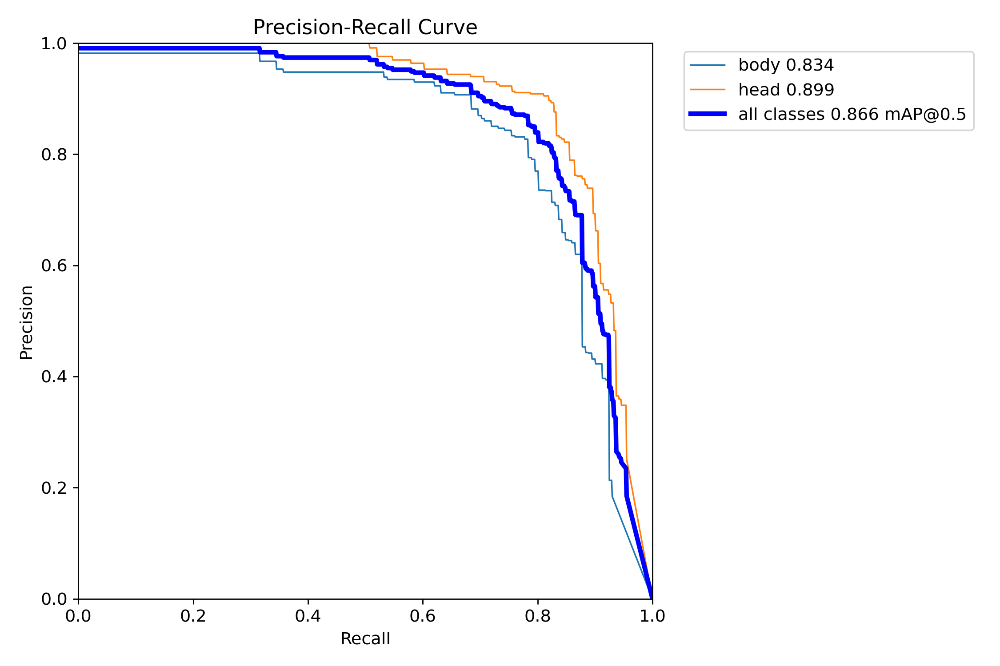

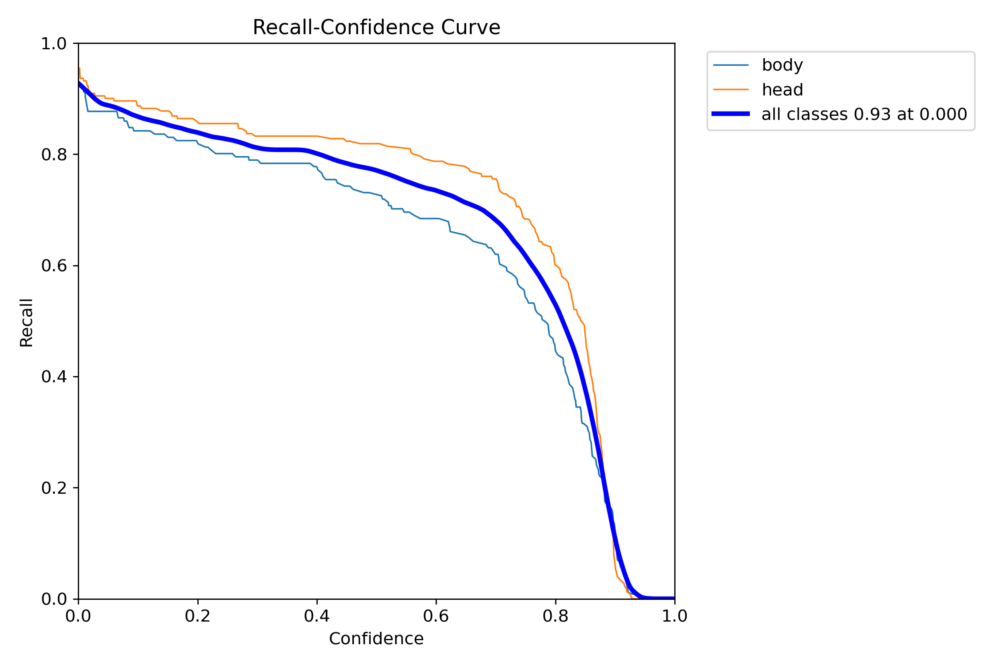

In [7]:
# dislaying train data metrics

from IPython.display import Image
from IPython.display import display

x1 = Image(filename='runs/detect/train/F1_curve.png')
x2 = Image(filename='runs/detect/train/P_curve.png')
x3 = Image(filename='runs/detect/train/PR_curve.png')
x4 = Image(filename='runs/detect/train/R_curve.png')

display(x1, x2, x3, x4)

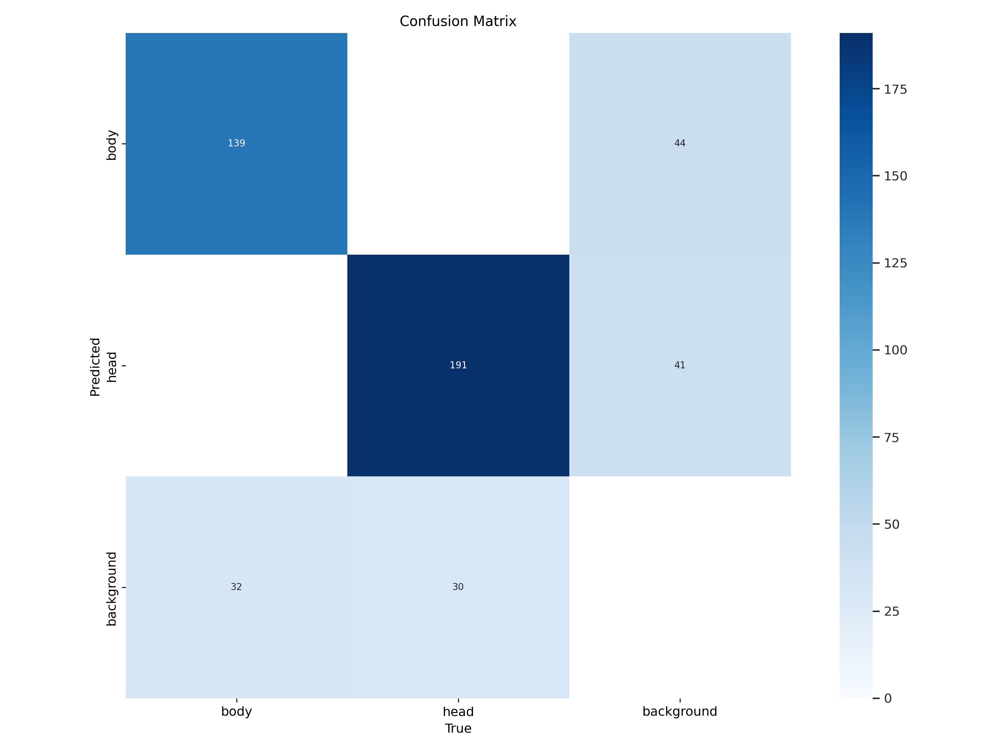

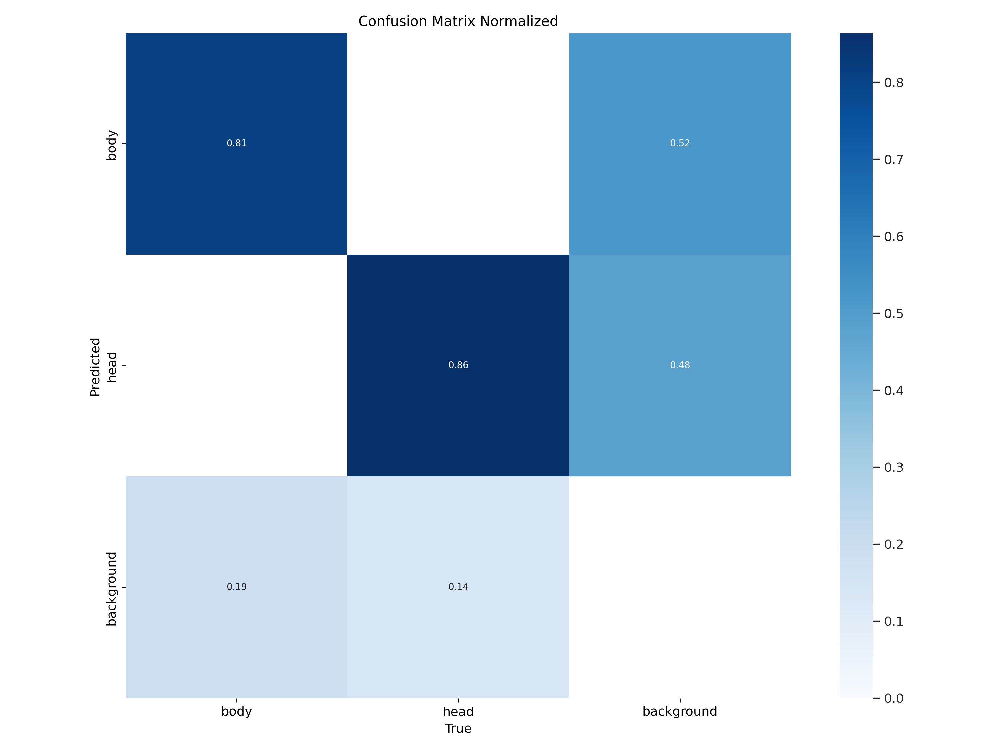

In [8]:
y1 = Image(filename='runs/detect/train/confusion_matrix.png')
y2 = Image(filename='runs/detect/train/confusion_matrix_normalized.png')
display(y1, y2)

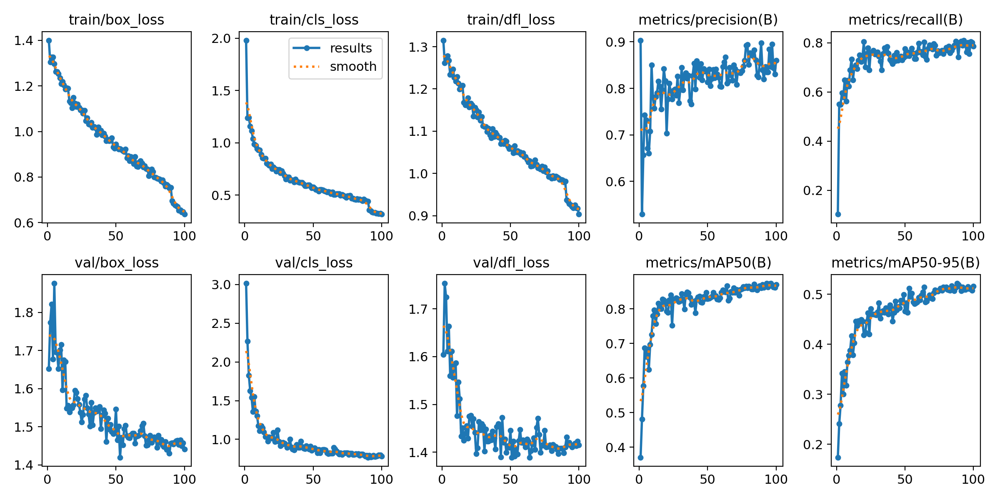

In [9]:
Image(filename=f'/content/runs/detect/train/results.png', width = 600)

# **Model Weight and Analysis**

In [10]:
import locale
print(locale.getpreferredencoding())

ANSI_X3.4-1968


In [11]:
import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding

In [12]:
# checking the latest trained files
!ls 'runs/detect/train/weights'

best.pt  last.pt


In [13]:
# loading the trianed model
model = YOLO("runs/detect/train/weights/best.pt")

In [14]:
!yolo task=detect mode=predict model="runs/detect/train/weights/best.pt" source='/content/drive/My Drive/Camera Roll/sit_video.mp4'

Ultralytics YOLOv8.1.27 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 168 layers, 3006038 parameters, 0 gradients, 8.1 GFLOPs

video 1/1 (frame 1/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 288x512 2 bodys, 1 head, 119.4ms
video 1/1 (frame 2/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 288x512 2 bodys, 1 head, 7.4ms
video 1/1 (frame 3/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 288x512 2 bodys, 1 head, 7.0ms
video 1/1 (frame 4/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 288x512 2 bodys, 1 head, 8.0ms
video 1/1 (frame 5/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 288x512 2 bodys, 1 head, 7.0ms
video 1/1 (frame 6/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 288x512 2 bodys, 1 head, 6.9ms
video 1/1 (frame 7/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 288x512 2 bodys, 1 head, 6.9ms
video 1/1 (frame 8/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 2

In [15]:
!ls 'runs/detect/predict'

sit_video.avi


In [16]:
from moviepy.editor import *

path="runs/detect/predict/sit_video.avi"

clip=VideoFileClip(path)
clip.ipython_display(width=600)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



t:  99%|█████████▊| 299/303 [00:01<00:00, 162.79it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/moviepy/video/io/ffmpeg_reader.py:123: UserWarning: Warning: in file runs/detect/predict/sit_video.avi, 2764800 bytes wanted but 0 bytes read,at frame 302/303, at time 10.07/10.07 sec. Using the last valid frame instead.
  warnings.warn("Warning: in file %s, "%(self.filename)+



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [17]:
!yolo task=detect mode=predict model="runs/detect/train/weights/best.pt" source='/content/drive/My Drive/Camera Roll/side_video.mp4'

Ultralytics YOLOv8.1.27 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 168 layers, 3006038 parameters, 0 gradients, 8.1 GFLOPs

video 1/1 (frame 1/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 288x512 1 body, 1 head, 119.3ms
video 1/1 (frame 2/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 288x512 1 body, 1 head, 7.5ms
video 1/1 (frame 3/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 288x512 1 body, 1 head, 7.1ms
video 1/1 (frame 4/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 288x512 1 body, 1 head, 7.2ms
video 1/1 (frame 5/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 288x512 1 body, 1 head, 7.3ms
video 1/1 (frame 6/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 288x512 1 body, 1 head, 7.0ms
video 1/1 (frame 7/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 288x512 1 body, 1 head, 6.9ms
video 1/1 (frame 8/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 

In [18]:
!ls 'runs/detect/predict2'

side_video.avi


In [19]:
from moviepy.editor import *

path="runs/detect/predict2/side_video.avi"

clip=VideoFileClip(path)
clip.ipython_display(width=600)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [20]:
import shutil

shutil.copy("runs/detect/train/weights/best.pt", "/content/drive/My Drive/all_body_update/")

'/content/drive/My Drive/all_body_update/best.pt'